In [17]:
import pandas as pd
#import geopandas as gpd
import matplotlib.pyplot as plt
from plotnine import *

In [18]:
df = pd.read_csv('data/clean/immoscout.csv')
df

,location,description,detailed_description,url,table,title,address,link,ForestDensityL,ForestDensityM,...,gde_workers_total,type,rooms,floor,living_space_m2,floor_space_m2,plot_area_m2,availability,municipality,price
0,"5023 Biberstein, AG","3.5 rooms, 100 m²«Luxuriöse Attika-Wohnung mit...",DescriptionLuxuriöse Attika-Wohnung direkt an ...,https://www.immoscout24.ch//en/d/penthouse-buy...,b <article class=####Box-cYFBPY hKrxoH####><h2...,Luxuriöse Attika-Wohnung mit herrlicher Aussicht,"5023 Biberstein, AG",/en/d/penthouse-buy-biberstein/7255200,0.511176,0.286451,...,331.0,penthouse,5.0,4,100.0,NaN,NaN,On request,Biberstein,1150000.0
1,"Buhldenstrasse 8d5023 Biberstein, AG","4.5 rooms, 156 m²«Stilvolle Liegenschaft - ruh...",DescriptionStilvolle Liegenschaft an ruhiger L...,https://www.immoscout24.ch//en/d/terrace-house...,b <article class=####Box-cYFBPY hKrxoH####><h2...,"Stilvolle Liegenschaft - ruhige Lage, unverbau...","Buhldenstrasse 8d, 5023 Biberstein, AG",/en/d/terrace-house-buy-biberstein/7266694,0.511176,0.286451,...,331.0,terrace-house,5.0,NaN,156.0,242.0,222,On request,Biberstein,1420000.0
2,"5022 Rombach, AG","2.5 rooms, 93 m²«Moderne, lichtdurchflutete At...","detail_responsive#description_title2,5 Zimmerw...",https://www.immoscout24.ch//en/d/penthouse-buy...,b <article class=####Box-cYFBPY hKrxoH####><h2...,"Moderne, lichtdurchflutete Attikawohnung mit E...","5022 Rombach, AG",/en/d/penthouse-buy-rombach/7261389,0.163362,0.095877,...,33493.0,penthouse,5.0,NaN,93.0,NaN,NaN,NaN,NaN,720000.0
3,"Buhaldenstrasse 8A5023 Biberstein, AG","4.5 rooms, 154 m²«AgentSelly - Luxuriöses Eckh...",DescriptionDieses äusserst grosszügige Minergi...,https://www.immoscout24.ch//en/d/detached-hous...,b <article class=####Box-cYFBPY hKrxoH####><h2...,AgentSelly - Luxuriöses Eckhaus an toller Süd-...,"Buhaldenstrasse 8A, 5023 Biberstein, AG",/en/d/detached-house-buy-biberstein/7047212,0.511176,0.286451,...,331.0,detached-house,5.0,NaN,154.0,257.0,370,On request,Biberstein,1430000.0
4,"5022 Rombach, AG","4.5 rooms, 142 m²«MIT GARTENSITZPLATZ UND VIEL...",DescriptionAus ehemals zwei Wohnungen wurde ei...,https://www.immoscout24.ch//en/d/flat-buy-romb...,b <article class=####Box-cYFBPY hKrxoH####><h2...,MIT GARTENSITZPLATZ UND VIELEN EXTRAS,"5022 Rombach, AG",/en/d/flat-buy-rombach/7293107,0.333865,0.279276,...,1355.0,flat,5.0,0,142.0,NaN,NaN,On request,Küttigen,995000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13373,"Tägerackerstrasse 138610 Uster, ZH","2.5 rooms, 70 m²«Wunderschöne Attikawohnung an...",DescriptionIn einem der schönsten Quartiere Us...,https://www.immoscout24.ch//en/d/flat-buy-uste...,b <article class=####Box-cYFBPY hKrxoH####><h2...,Wunderschöne Attikawohnung an bester Lage,"Tägerackerstrasse 13, 8610 Uster, ZH",/en/d/flat-buy-uster/7204386,0.089304,0.000000,...,16330.0,flat,5.0,NaN,70.0,NaN,NaN,On request,Uster,1101000.0
13374,"8604 Volketswil, ZH",8 rooms«Charmantes 2-Familienhaus im idyllisch...,DescriptionWillkommen im Herzen von Volketswil...,https://www.immoscout24.ch//en/d/semi-detached...,b <article class=####Box-cYFBPY hKrxoH####><h2...,Charmantes 2-Familienhaus im idyllischen Volke...,"8604 Volketswil, ZH",/en/d/semi-detached-house-buy-volketswil/7206067,0.120618,0.054523,...,11124.0,semi-detached-house,8.0,NaN,284.0,NaN,284,On request,Volketswil,1750000.0
13375,"8472 Seuzach, ZH","6.5 rooms, 150 m²«EIN PARADIES IM GRÜNEN FÜR G...",DescriptionWir verkaufen dieses unglaublich to...,https://www.immoscout24.ch//en/d/terrace-house...,b <article class=####Box-cYFBPY hKrxoH####><h2...,EIN PARADIES IM GRÜNEN FÜR GROSS UND KLEIN,"8472 Seuzach, ZH",/en/d/terrace-house-buy-seuzach/7296177,0.007178,0.000000,...,626.0,terrace-house,5.0,NaN,150.0,NaN,160,On request,Seuzach,1415000.0
13376,"Vordere Bähntalstrasse 18483 Kollbrunn, ZH","6 rooms, 145 m²«Freistehendes 6.0 Zimmer . Ein...",Description####Freistehendes 6.0 Zimmer . Einf...,https://www.immoscout24.ch//en/d/detached-h

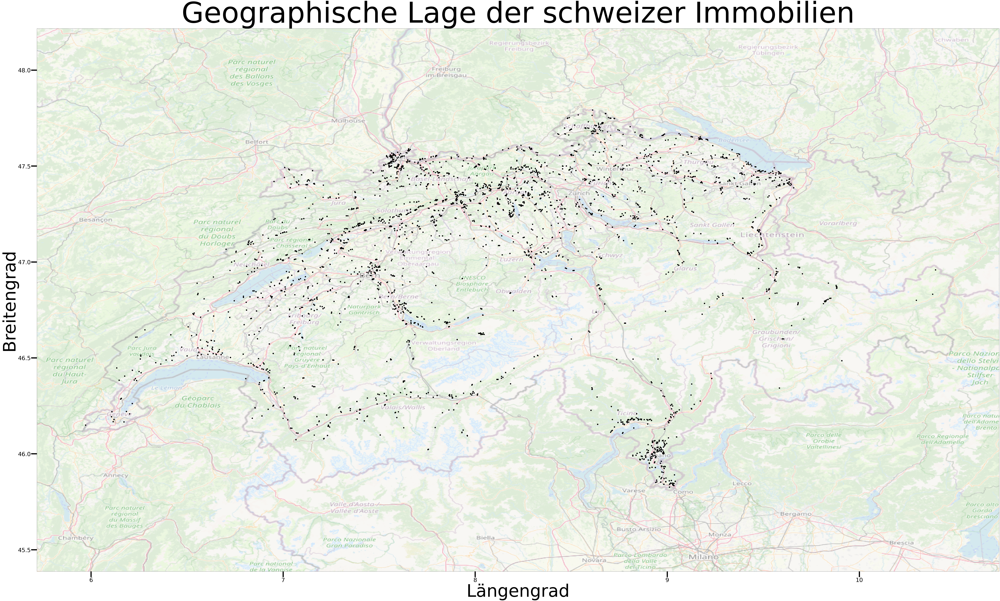

In [19]:
#png and coordinates in "BBox" from "https://www.openstreetmap.org/"
BBox = (5.718,  10.728,      
         45.387, 48.217)

pic = plt.imread('bilder_plots/schweiz.png')
    
fig, ax = plt.subplots(figsize = (150,150))

ax.scatter(df.Longitude, df.Latitude, c="black", s=100)

ax.set_title('Geographische Lage der schweizer Immobilien', fontsize=250)
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.set_xlabel('Längengrad', fontsize=150)
ax.set_ylabel('Breitengrad', fontsize=150)
ax.tick_params(axis='both', direction = "out", length = 50, width = 10, colors = "black", labelsize=50)
ax.imshow(pic, zorder=0, extent = BBox, aspect= 'equal', alpha = 0.5)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/plotnine/layer.py:401: PlotnineWarning: geom_point : Removed 1457 rows containing missing values.


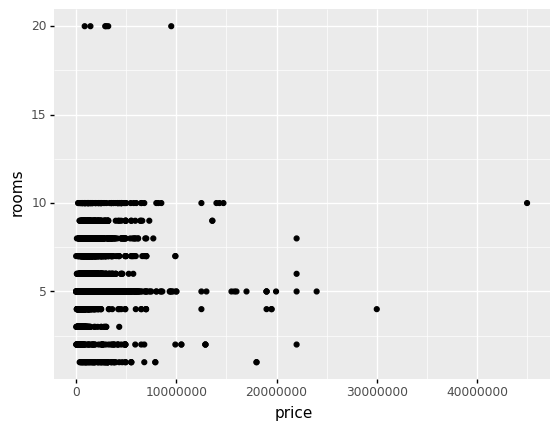

<ggplot: (834812229)>

In [20]:
#scatterplot x axis = price, y axis = rooms
ggplot(df, aes(x='price', y='rooms')) + geom_point()

In [21]:
#rows where price is over 10000000
df_over_10mio = df[df.price > 10000000]
df_over_10mio.sort_values(by=['price'], ascending=False)

,location,description,detailed_description,url,table,title,address,link,ForestDensityL,ForestDensityM,...,gde_workers_total,type,rooms,floor,living_space_m2,floor_space_m2,plot_area_m2,availability,municipality,price
10680,"1162 St-Prex, VD",10 rooms«Somptueuse propriété pieds dans l eau...,DescriptionCette propriété de maître ####pieds...,https://www.immoscout24.ch//en/d/detached-hous...,b <article class=####Box-cYFBPY hKrxoH####><h2...,Somptueuse propriété pieds dans l'eau à l'abri...,"1162 St-Prex, VD",/en/d/detached-house-buy-st-prex/7242923,0.001743,0.000000,...,2734.0,detached-house,10.0,NaN,5000.0,NaN,5000,On request,Saint-Prex,45000000.0
11028,"1295 Tannay, VD","14 rooms, 1200 m²«Splendide propriété pied dan...",BeschreibungNous vous présentons cette superbe...,https://www.immoscout24.ch//en/d/detached-hous...,b <article class=####Box-cYFBPY hKrxoH####><h2...,Splendide propriété pied dans l'eau à Terre Sa...,"1295 Tannay, VD",/en/d/detached-house-buy-tannay/7287224,0.135525,0.060782,...,4157.0,detached-house,4.0,NaN,1200.0,NaN,8071,On request,Tannay,30000000.0
10217,"1006 Lausanne, VD","14.5 rooms, 700 m²«Résidence de l Elysée»CHF 2...",DescriptionSituée dans le plus prestigieux qua...,https://www.immoscout24.ch//en/d/detached-hous...,b <article class=####Box-cYFBPY hKrxoH####><h2...,Résidence de l'Elysée,"1006 Lausanne, VD",/en/d/detached-house-buy-lausanne/7257669,0.024808,0.028412,...,117705.0,detached-house,5.0,NaN,700.0,900.0,5039,On request,Lausanne,24000000.0
11034,"1295 Tannay, VD","16 rooms, 745 m²«Villa pieds dans l eau à Terr...",DescriptionAgence : Millenium Properties SARéf...,https://www.immoscout24.ch//en/d/detached-hous...,b <article class=####Box-cYFBPY hKrxoH####><h2...,Villa pieds dans l'eau à Terre Sainte,"1295 Tannay, VD",/en/d/detached-house-buy-tannay/7076351,0.135525,0.060782,...,4157.0,detached-house,6.0,NaN,745.0,NaN,5000,On request,Tannay,22000000.0
11069,"1295 Tannay, VD",8 rooms«Propriété pied-dans-l eau avec port et...,DescriptionCette superbe parcelle de 5000 m2 r...,https://www.immoscout24.ch//en/d/detached-hous...,b <article class=####Box-cYFBPY hKrxoH####><h2...,Propriété pied-dans-l'eau avec port et plage p...,"1295 Tannay, VD",/en/d/detached-house-buy-tannay/6713748,0.135525,0.060782,...,4157.0,detached-house,8.0,NaN,5000.0,780.0,5000,Immediately,Tannay,22000000.0
11046,"1295 Tannay, VD","12 rooms, 600 m²«Villa pieds dans l eau avec h...",DescriptionLa ravissante propriété a été pensé...,https://www.immoscout24.ch//en/d/detached-hous...,b <article class=####Box-cYFBPY hKrxoH####><h2...,Villa pieds dans l'eau avec hangar à bateaux,"1295 Tannay, VD",/en/d/detached-house-buy-tannay/6881871,0.135525,0.060782,...,4157.0,detached-house,2.0,NaN,600.0,NaN,5000,On request,Tannay,22000000.0
11012,"1295 Tannay, VD","15 rooms, 804 m²«Exceptionnelle propriété les ...",DescriptionROCKWELL PROPERTIES SA VOUS PRESENT...,https://www.immoscout24.ch//en/d/villa-buy-tan...,b <article class=####Box-cYFBPY hKrxoH####><h2...,Exceptionnelle propriété les pieds dans l'eau,"1295 Tannay, VD",/en/d/villa-buy-tannay/7293767,0.135525,0.060782,...,4157.0,villa,5.0,NaN,804.0,NaN,8071,Immediately,Tannay,22000000.0
11316,"1815 Clarens, VD","9.5 rooms, 560 m²«Somptueuse propriété avec vu...",DescriptionCette somptueuse propriété construi...,https://www.immoscout24.ch//en/d/detached-hous...,b <article class=####Box-cYFBPY hKrxoH####><h2...,Somptueuse propriété avec vue sur le lac à Cla...,"1815 Clarens, VD",/en/d/detached-house-buy-clarens/6906606,0.000000,0.000000,...,12380.0,detached-house,5.0,NaN,560.0,NaN,3301,On request,Montreux,19950000.0
3826,"1245 Collonge-Bellerive, GE","14 rooms, 594 m²«Superbe propriété à Collonge ...",DescriptionStone Invest Finest Homes vous prop...,https://www.immoscout24.ch//en/d/detached-hous...,b <article class=####Box-cYFBPY hKrxoH####><h2...,Superbe propriété à Collonge Bellerive,"1245 Collonge-Bellerive, GE",/en/d/detached-house-buy-collonge-bellerive/72...,0.034854,0.025740,...,302

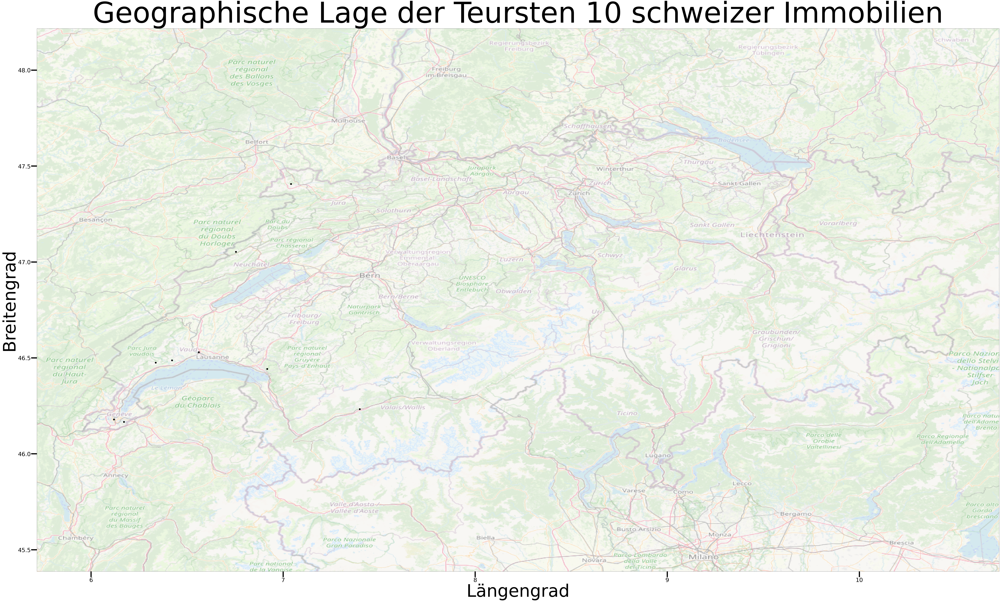

In [22]:
#png and coordinates in "BBox" from "https://www.openstreetmap.org/"
BBox = (5.718,  10.728,      
         45.387, 48.217)

pic = plt.imread('bilder_plots/schweiz.png')
    
fig, ax = plt.subplots(figsize = (150,150))

ax.scatter(df_cheap.Longitude, df_cheap.Latitude, c="black", s=200)

ax.set_title('Geographische Lage der Teursten 10 schweizer Immobilien', fontsize=250)
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
ax.set_xlabel('Längengrad', fontsize=150)
ax.set_ylabel('Breitengrad', fontsize=150)
ax.tick_params(axis='both', direction = "out", length = 50, width = 10, colors = "black", labelsize=50)
ax.imshow(pic, zorder=0, extent = BBox, aspect= 'equal', alpha = 0.5)

In [23]:
df_only_numeric = pd.read_csv("data/clean/immoscout_only_numeric.csv")
df_only_numeric

,Unnamed: 0,ForestDensityL,ForestDensityM,ForestDensityS,Latitude,Longitude,NoisePollutionRailwayL,NoisePollutionRailwayM,NoisePollutionRailwayS,NoisePollutionRoadL,...,gde_workers_total,type,rooms,floor,living_space_m2,floor_space_m2,plot_area_m2,availability,municipality,price
0,0,0.511176,0.286451,0.090908,47.415927,8.085840,0.000000,0.0,0.0,0.058298,...,331.0,penthouse,5.0,4,100.0,NaN,NaN,On request,Biberstein,1150000.0
1,1,0.511176,0.286451,0.090908,47.415927,8.085840,0.000000,0.0,0.0,0.058298,...,331.0,terrace-house,5.0,NaN,156.0,242.0,222,On request,Biberstein,1420000.0
2,2,0.163362,0.095877,0.001911,47.397416,8.043150,0.000000,0.0,0.0,0.334957,...,33493.0,penthouse,5.0,NaN,93.0,NaN,NaN,NaN,NaN,720000.0
3,3,0.511176,0.286451,0.090908,47.415927,8.085840,0.000000,0.0,0.0,0.058298,...,331.0,detached-house,5.0,NaN,154.0,257.0,370,On request,Biberstein,1430000.0
4,4,0.333865,0.279276,0.145835,47.404870,8.052781,0.000000,0.0,0.0,0.133498,...,1355.0,flat,5.0,0,142.0,NaN,NaN,On request,Küttigen,995000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13373,13373,0.089304,0.000000,0.000000,47.341095,8.719508,0.000000,0.0,0.0,0.306013,...,16330.0,flat,5.0,NaN,70.0,NaN,NaN,On request,Uster,1101000.0
13374,13374,0.120618,0.054523,0.000000,47.387817,8.692746,0.000000,0.0,0.0,0.330695,...,11124.0,semi-detached-house,8.0,NaN,284.0,NaN,284,On request,Volketswil,1750000.0
13375,13375,0.007178,0.000000,0.000000,47.545958,8.708230,0.000000,0.0,0.0,0.164688,...,626.0,terrace-house,5.0,NaN,150.0,NaN,160,On request,Seuzach,1415000.0
13376,13376,0.249841,0.112081,0.000000,47.433114,8.762768,0.000000,0.0,0.0,0.203866,...,857.0,detached-house,6.0,NaN,145.0,140.0,853,Immediately,Zell (ZH),1465000.0


In [24]:
#korrelation matrix
corrMatrix = df_only_numeric.corr(method = "pearson")
corrMatrix

,Unnamed: 0,ForestDensityL,ForestDensityM,ForestDensityS,Latitude,Longitude,NoisePollutionRailwayL,NoisePollutionRailwayM,NoisePollutionRailwayS,NoisePollutionRoadL,...,gde_social_help_quota,gde_tax,gde_workers_sector1,gde_workers_sector2,gde_workers_sector3,gde_workers_total,rooms,living_space_m2,floor_space_m2,price
Unnamed: 0,1.000000,0.089952,0.109840,0.123573,-0.522791,-0.077171,-0.040293,-0.035295,-0.021803,0.069494,...,-0.081292,-0.215902,0.009871,-0.036029,0.042755,0.033079,0.008259,0.004009,-0.008203,0.062792
ForestDensityL,0.089952,1.000000,0.911491,0.710585,-0.291478,0.273650,-0.178291,-0.122853,-0.043922,-0.313300,...,-0.277705,-0.278947,-0.127271,-0.149996,-0.091293,-0.101861,-0.018550,-0.000913,0.014307,-0.075012
ForestDensityM,0.109840,0.911491,1.000000,0.867609,-0.287520,0.203794,-0.166243,-0.122354,-0.047800,-0.250185,...,-0.239732,-0.245040,-0.105993,-0.097260,-0.041201,-0.050198,-0.013900,0.001202,0.028756,-0.037494
ForestDensityS,0.123573,0.710585,0.867609,1.000000,-0.227517,0.138276,-0.133305,-0.098211,-0.037609,-0.182188,...,-0.219837,-0.193648,-0.066691,-0.077735,-0.035172,-0.042027,-0.018115,0.002633,0.012728,-0.040029
Latitude,-0.522791,-0.291478,-0.287520,-0.227517,1.000000,0.058665,0.082889,0.067677,0.051775,-0.132135,...,0.085009,0.435331,0.049298,0.074220,-0.035433,-0.021142,-0.014298,-0.022769,-0.015421,-0.087020
Longitude,-0.077171,0.273650,0.203794,0.138276,0.058665,1.000000,0.013093,0.042213,0.064067,0.014625,...,-0.290139,-0.500704,0.062690,0.041695,0.002051,0.007757,-0.055784,-0.046336,-0.078081,-0.128433
NoisePollutionRailwayL,-0.040293,-0.178291,-0.166243,-0.133305,0.082889,0.013093,1.000000,0.834379,0.567219,0.292311,...,0.182007,0.039996,0.002251,0.032400,-0.002216,0.002435,-0.031499,-0.023792,-0.024436,-0.039152
NoisePollutionRailwayM,-0.035295,-0.122853,-0.122354,-0.098211,0.067677,0.042213,0.834379,1.000000,0.786403,0.241356,...,0.114331,0.026993,-0.013315,0.030020,0.003380,0.007004,-0.026426,-0.017937,-0.003703,-0.028371
NoisePollutionRailwayS,-0.021803,-0.043922,-0.047800,-0.037609,0.051775,0.064067,0.567219,0.786403,1.000000,0.174451,...,0.045762,-0.014219,-0.036162,0.001381,-0.015371,-0.013609,-0.023738,-0.017900,0.007307,-0.027919
NoisePollutionRoadL,0.069494,-0.313300,-0.250185,-0.182188,-0.132135,0.014625,0.292311,0.241356,0.174451,1.000000,...,0.306314,-0.127092,-0.064509,0.234988,0.253429,0.256277,0.005759,0.007353,-0.002727,0.103870


IndexError: index 53 is out of bounds for axis 1 with size 53

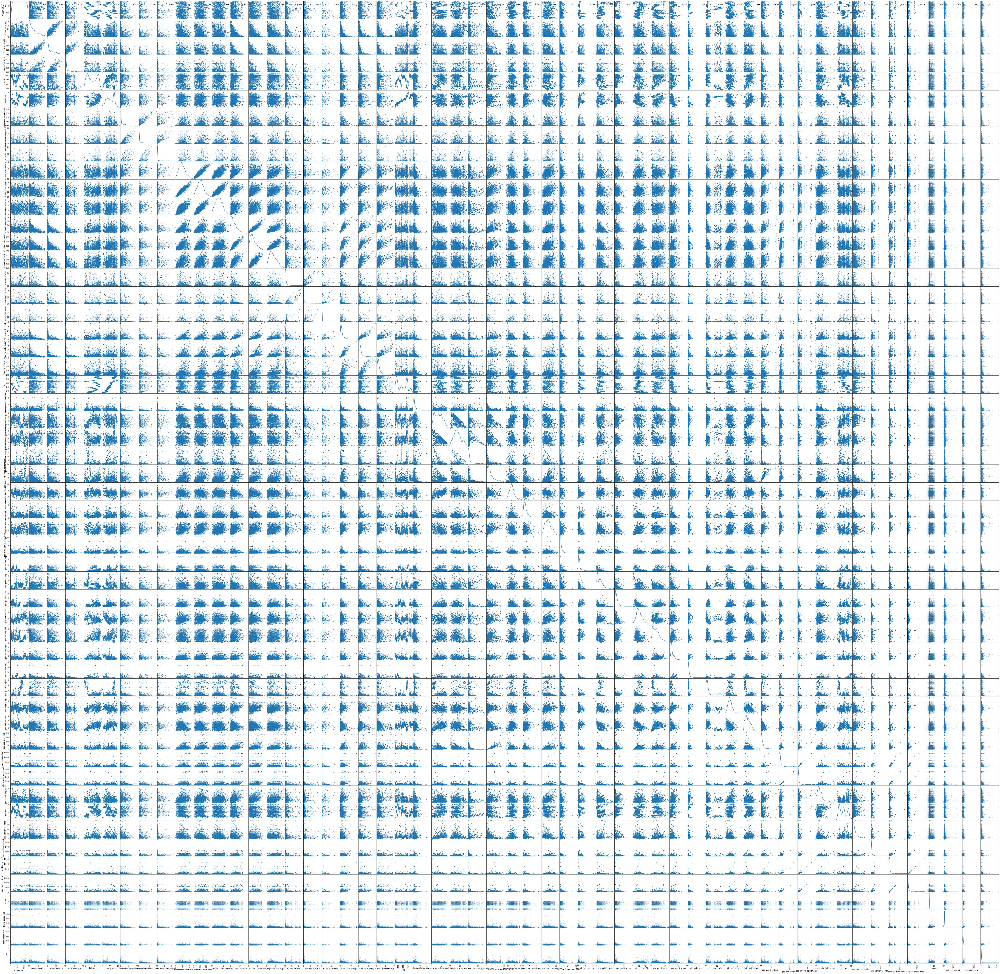

In [25]:
axes = pd.plotting.scatter_matrix(df_only_numeric, alpha=0.2, diagonal="kde", figsize=(100, 100))
corr = df.corr().to_numpy()
for i, j in zip(*plt.np.triu_indices_from(axes, k=1)):
    axes[i, j].annotate("%.3f" %corr[i,j], (0.8, 0.8), xycoords='axes fraction', ha='center', va='center')
plt.show()

In [ ]:
#alle Reihen die eine Korrelation über 0.8 (--> Starke Korrelation)
for i in range(len(corrMatrix)):
    for j in range(len(corrMatrix)):
        if corrMatrix.iloc[i,j] > 0.8 and corrMatrix.iloc[i,j] != 1:
            print(corrMatrix.index[i], corrMatrix.columns[j], corrMatrix.iloc[i,j])


ForestDensityL ForestDensityM 0.9114909095381499
ForestDensityM ForestDensityL 0.9114909095381499
ForestDensityM ForestDensityS 0.8676090226762789
ForestDensityS ForestDensityM 0.8676090226762789
Longitude Zip 0.9460298367288767
NoisePollutionRailwayL NoisePollutionRailwayM 0.8343790570503911
NoisePollutionRailwayM NoisePollutionRailwayL 0.8343790570503911
NoisePollutionRoadL NoisePollutionRoadM 0.9040623034427968
NoisePollutionRoadM NoisePollutionRoadL 0.9040623034427968
NoisePollutionRoadM NoisePollutionRoadS 0.8430971070480482
NoisePollutionRoadS NoisePollutionRoadM 0.8430971070480482
PopulationDensityL PopulationDensityM 0.9202544032244113
PopulationDensityL WorkplaceDensityL 0.8014977199828
PopulationDensityM PopulationDensityL 0.9202544032244113
PopulationDensityM PopulationDensityS 0.8658392151152488
PopulationDensityS PopulationDensityM 0.8658392151152488
RiversAndLakesL RiversAndLakesM 0.8335660032373315
RiversAndLakesM RiversAndLakesL 0.8335660032373315
WorkplaceDensityL Popu